In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#### control
ctrl_hc1 = pd.read_csv('project_rsfmri/control/sub-HC031_ses-on.csv', header= None).to_numpy()
ctrl_hc2 = pd.read_csv('project_rsfmri/control/sub-HC032_ses-on.csv', header= None).to_numpy()
ctrl_hc3 = pd.read_csv('project_rsfmri/control/sub-HC033_ses-on.csv', header= None).to_numpy()
ctrl_hc4 = pd.read_csv('project_rsfmri/control/sub-HC034_ses-on.csv', header= None).to_numpy()
ctrl_hc5 = pd.read_csv('project_rsfmri/control/sub-HC035_ses-on.csv', header= None).to_numpy()


#### parkinson
ctrl_pd1 = pd.read_csv('project_rsfmri/parkin/sub-PD025_ses-on.csv', header= None).to_numpy()
ctrl_pd2 = pd.read_csv('project_rsfmri/parkin/sub-PD026_ses-on.csv', header= None).to_numpy()
ctrl_pd3 = pd.read_csv('project_rsfmri/parkin/sub-PD027_ses-on.csv', header= None).to_numpy()
ctrl_pd4 = pd.read_csv('project_rsfmri/parkin/sub-PD028_ses-on.csv', header= None).to_numpy()
ctrl_pd5 = pd.read_csv('project_rsfmri/parkin/sub-PD029_ses-on.csv', header= None).to_numpy()


In [3]:
print(np.min(ctrl_hc1), np.max(ctrl_hc1))
print(np.min(ctrl_hc2), np.max(ctrl_hc2))
print(np.min(ctrl_hc3), np.max(ctrl_hc3))
print(np.min(ctrl_hc4), np.max(ctrl_hc4))
print(np.min(ctrl_hc5), np.max(ctrl_hc5))



print(np.min(ctrl_pd1), np.max(ctrl_pd1))
print(np.min(ctrl_pd2), np.max(ctrl_pd2))
print(np.min(ctrl_pd3), np.max(ctrl_pd3))
print(np.min(ctrl_pd4), np.max(ctrl_pd4))
print(np.min(ctrl_pd5), np.max(ctrl_pd5))

-0.619693 1.509098
-0.770674 1.207498
-0.600681 1.48816
-0.875555 1.540888
-0.959196 1.41645
-0.743324 1.579249
-0.851789 1.568682
-0.837552 1.512961
-1.305136 1.443591
-0.654464 1.216253


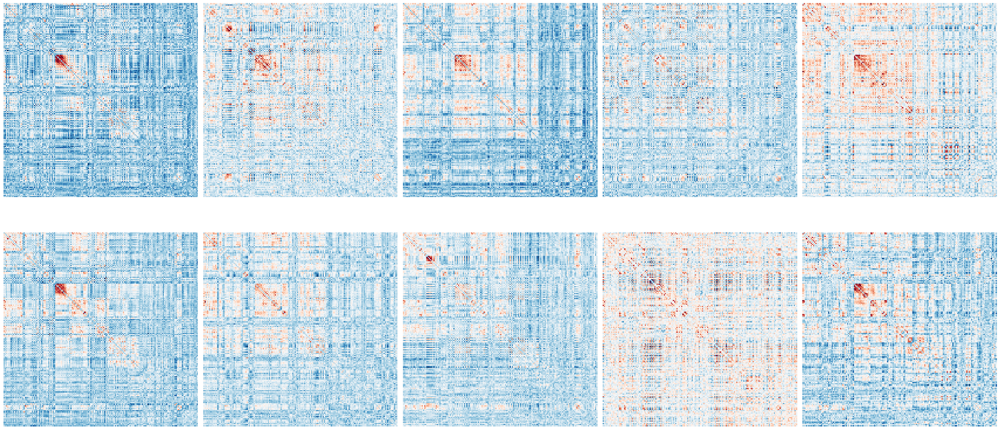

In [4]:
# plt.imshow(ctrl_hc1, cmap='RdBu_r', interpolation='nearest')
# plt.show()
fig, axes = plt.subplots(2,5, figsize=(28, 14))

# mask_hc1 = np.zeros_like(ctrl_hc1)
# mask_hc1[np.triu_indices_from(mask_hc1)] = True
sns.heatmap(ctrl_hc1, square=True,  cmap="RdBu_r", ax = axes[0,0], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_hc2, square=True,  cmap="RdBu_r", ax = axes[0,1], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_hc3, square=True,  cmap="RdBu_r", ax = axes[0,2], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_hc4, square=True,  cmap="RdBu_r", ax = axes[0,3], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_hc5, square=True,  cmap="RdBu_r", ax = axes[0,4], cbar=False, xticklabels=False, yticklabels=False)


sns.heatmap(ctrl_pd1, square=True,  cmap="RdBu_r", ax = axes[1,0], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_pd2, square=True,  cmap="RdBu_r", ax = axes[1,1], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_pd3, square=True,  cmap="RdBu_r", ax = axes[1,2], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_pd4, square=True,  cmap="RdBu_r", ax = axes[1,3], cbar=False, xticklabels=False, yticklabels=False)
sns.heatmap(ctrl_pd5, square=True,  cmap="RdBu_r", ax = axes[1,4], cbar=False, xticklabels=False, yticklabels=False)
plt.tight_layout()
plt.show()

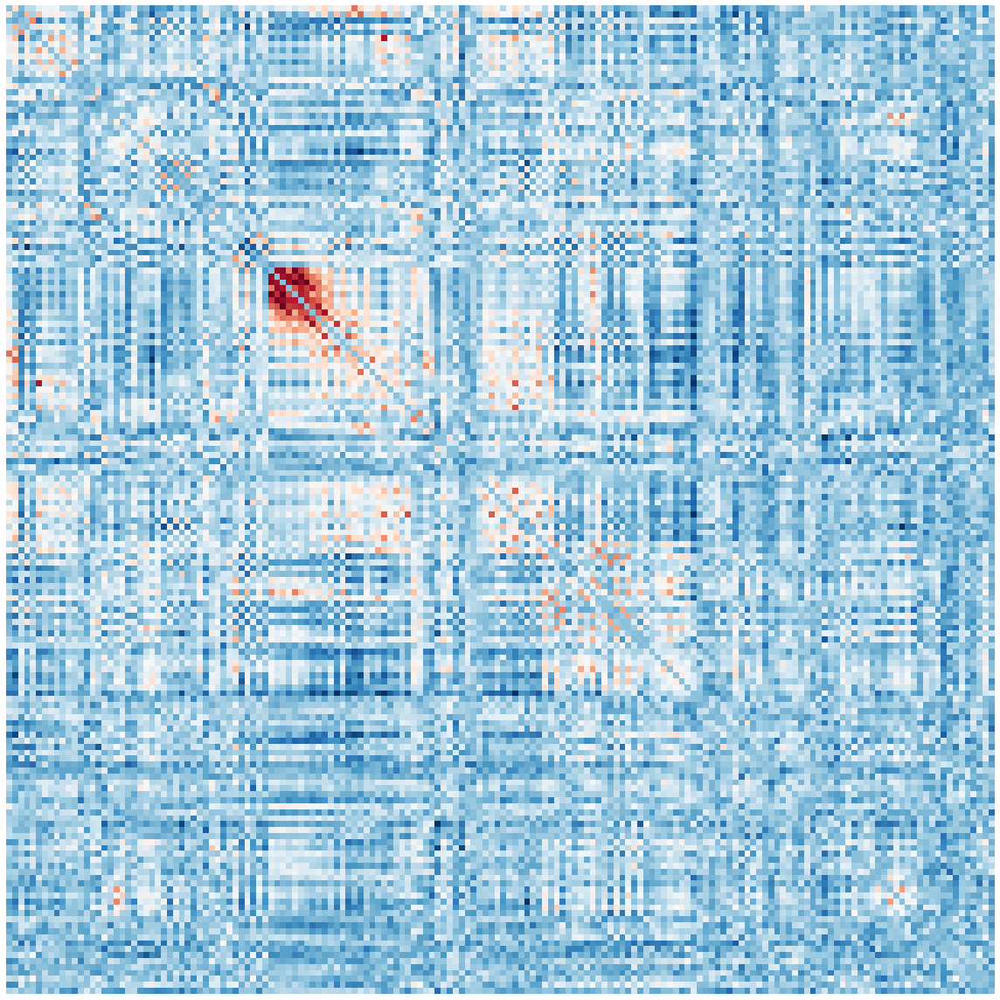

In [11]:
##### for PPT
fig, axes = plt.subplots(figsize=(16, 16))
sns.heatmap(ctrl_hc1, square=True,  cmap="RdBu_r", cbar=False, xticklabels=False, yticklabels=False)
plt.tight_layout()
plt.show()

In [24]:
abs_ctrl_hc1 = np.where((ctrl_hc1 > 0.25) | (ctrl_hc1 <= -0.25), ctrl_hc1, 0)

In [25]:
abs_ctrl_hc1

array([[0.      , 0.602343, 0.      , ..., 0.      , 0.      , 0.      ],
       [0.602343, 0.      , 0.      , ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.367697, 0.310664, 0.      ],
       ...,
       [0.      , 0.      , 0.367697, ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.310664, ..., 0.      , 0.      , 0.      ],
       [0.      , 0.      , 0.      , ..., 0.      , 0.      , 0.      ]])

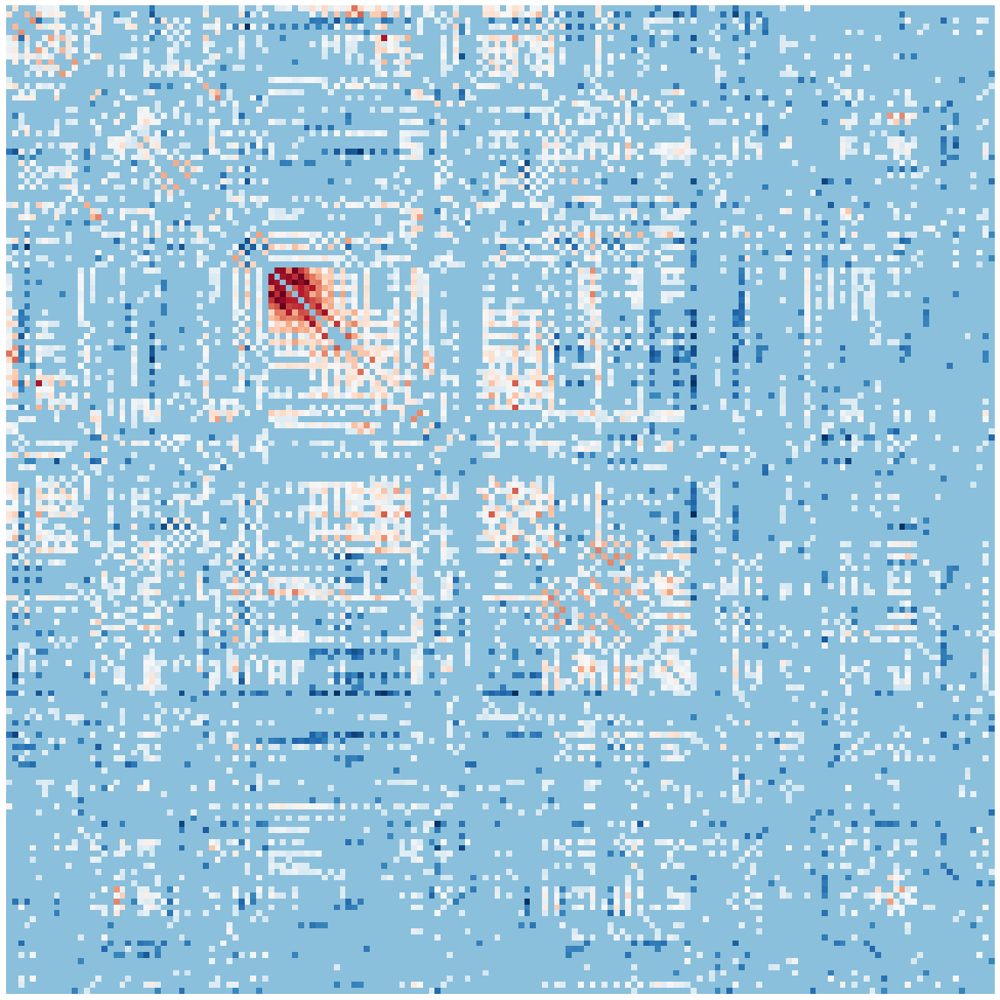

In [26]:
##### for PPT
fig, axes = plt.subplots(figsize=(16, 16))
sns.heatmap(abs_ctrl_hc1, square=True,  cmap="RdBu_r", cbar=False, xticklabels=False, yticklabels=False)
plt.tight_layout()
plt.show()

In [27]:
########### load the two matrix given by mac
stat_th = pd.read_csv('mac/BME516_project_sta_net_thres/control/sub-HC031-sta.csv', header= None).to_numpy()
netw_th = pd.read_csv('mac/BME516_project_sta_net_thres/control/sub-HC031-net.csv', header= None).to_numpy()

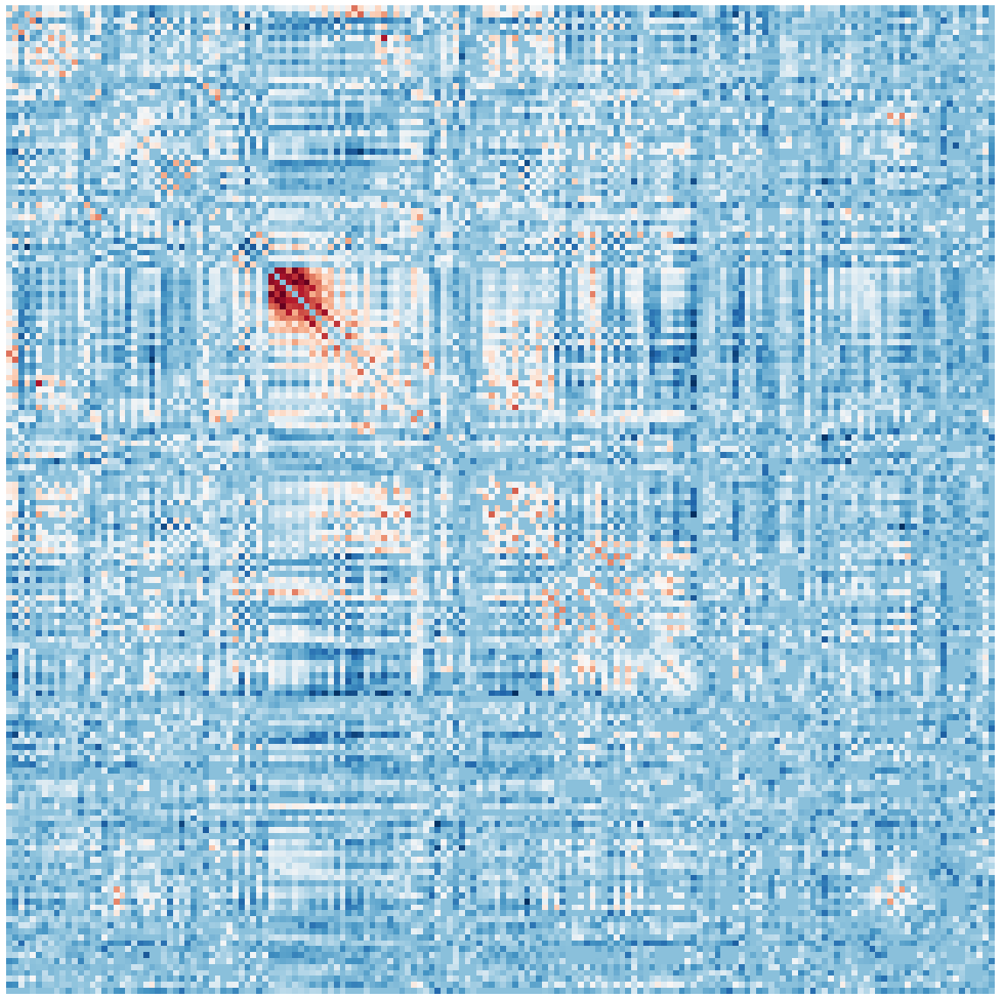

In [29]:
##### for PPT
fig, axes = plt.subplots(figsize=(16, 16))
sns.heatmap(netw_th, square=True,  cmap="RdBu_r", cbar=False, xticklabels=False, yticklabels=False)
plt.tight_layout()
plt.show()

In [5]:
def minus1toplus1(arr):
    
    
    return 2.*(arr - np.min(arr))/np.ptp(arr)-1

In [6]:
std_hc1 = minus1toplus1(ctrl_hc1)
std_hc2 = minus1toplus1(ctrl_hc2)
std_hc3 = minus1toplus1(ctrl_hc3)
std_hc4 = minus1toplus1(ctrl_hc4)
std_hc5 = minus1toplus1(ctrl_hc5)

std_pd1 = minus1toplus1(ctrl_pd1)
std_pd2 = minus1toplus1(ctrl_pd2)
std_pd3 = minus1toplus1(ctrl_pd3)
std_pd4 = minus1toplus1(ctrl_pd4)
std_pd5 = minus1toplus1(ctrl_pd5)

In [7]:
print(np.min(std_hc1), np.max(std_hc1))
print(np.min(std_hc2), np.max(std_hc2))
print(np.min(std_hc3), np.max(std_hc3))
print(np.min(std_hc4), np.max(std_hc4))
print(np.min(std_hc5), np.max(std_hc5))



print(np.min(std_pd1), np.max(std_pd1))
print(np.min(std_pd2), np.max(std_pd2))
print(np.min(std_pd3), np.max(std_pd3))
print(np.min(std_pd4), np.max(std_pd4))
print(np.min(std_pd5), np.max(std_pd5))

-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0
-1.0 1.0


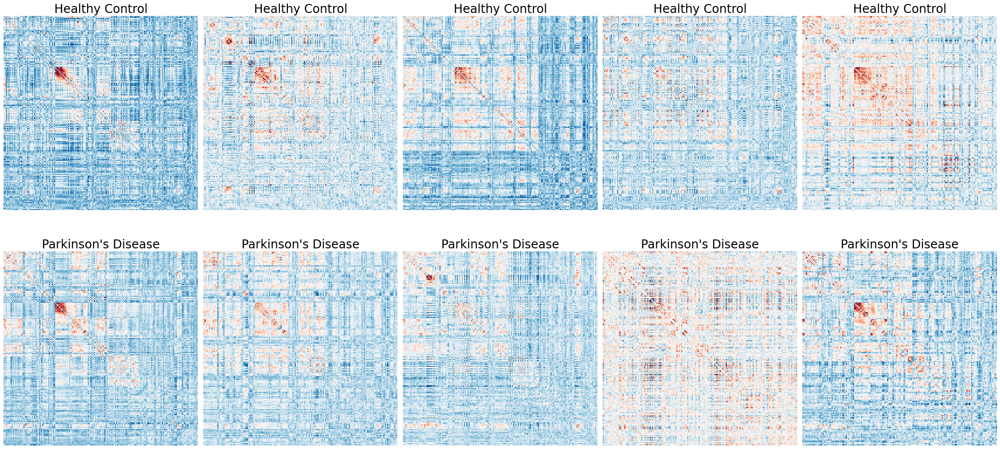

In [8]:
# plt.imshow(ctrl_hc1, cmap='RdBu_r', interpolation='nearest')
# plt.show()
fsize=24

fig, axes = plt.subplots(2,5, figsize=(28, 14))
# mask_hc1 = np.zeros_like(ctrl_hc1)
# mask_hc1[np.triu_indices_from(mask_hc1)] = True
ax01 = sns.heatmap(std_hc1, square=True,  cmap="RdBu_r", ax = axes[0,0], cbar=False, xticklabels=False, yticklabels=False)
ax01.set_title('Healthy Control', fontdict={'fontsize': fsize})

ax02 = sns.heatmap(std_hc2, square=True,  cmap="RdBu_r", ax = axes[0,1], cbar=False, xticklabels=False, yticklabels=False)
ax02.set_title('Healthy Control', fontdict={'fontsize': fsize})

ax03 = sns.heatmap(std_hc3, square=True,  cmap="RdBu_r", ax = axes[0,2], cbar=False, xticklabels=False, yticklabels=False)
ax03.set_title('Healthy Control', fontdict={'fontsize': fsize})

ax04 = sns.heatmap(std_hc4, square=True,  cmap="RdBu_r", ax = axes[0,3], cbar=False, xticklabels=False, yticklabels=False)
ax04.set_title('Healthy Control', fontdict={'fontsize': fsize})

ax05 = sns.heatmap(std_hc5, square=True,  cmap="RdBu_r", ax = axes[0,4], cbar=False, xticklabels=False, yticklabels=False)
ax05.set_title('Healthy Control', fontdict={'fontsize': fsize})

ax06 = sns.heatmap(std_pd1, square=True,  cmap="RdBu_r", ax = axes[1,0], cbar=False, xticklabels=False, yticklabels=False)
ax06.set_title("Parkinson's Disease", fontdict={'fontsize': fsize})

ax07 = sns.heatmap(std_pd2, square=True,  cmap="RdBu_r", ax = axes[1,1], cbar=False, xticklabels=False, yticklabels=False)
ax07.set_title("Parkinson's Disease", fontdict={'fontsize': fsize})

ax08 = sns.heatmap(std_pd3, square=True,  cmap="RdBu_r", ax = axes[1,2], cbar=False, xticklabels=False, yticklabels=False)
ax08.set_title("Parkinson's Disease", fontdict={'fontsize': fsize})

ax09 = sns.heatmap(std_pd4, square=True,  cmap="RdBu_r", ax = axes[1,3], cbar=False, xticklabels=False, yticklabels=False)
ax09.set_title("Parkinson's Disease", fontdict={'fontsize': fsize})

ax10 = sns.heatmap(std_pd5, square=True,  cmap="RdBu_r", ax = axes[1,4], cbar=False, xticklabels=False, yticklabels=False)
ax10.set_title("Parkinson's Disease", fontdict={'fontsize': fsize})

plt.tight_layout()
plt.show()

In [9]:
np.fill_diagonal(std_hc1, 0)
np.fill_diagonal(std_hc2, 0)
np.fill_diagonal(std_hc3, 0)
np.fill_diagonal(std_hc4, 0)
np.fill_diagonal(std_hc5, 0)

np.fill_diagonal(std_pd1, 0)
np.fill_diagonal(std_pd2, 0)
np.fill_diagonal(std_pd3, 0)
np.fill_diagonal(std_pd4, 0)
np.fill_diagonal(std_pd5, 0)

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


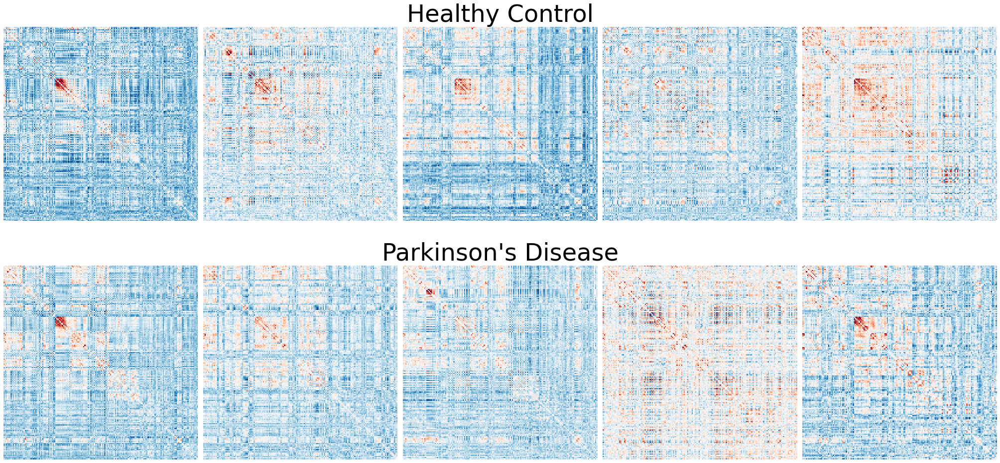

In [10]:
# plt.imshow(ctrl_hc1, cmap='RdBu_r', interpolation='nearest')
# plt.show()
fdict={'fontsize': 48, 'fontname':'Helvetica' }

fig, axes = plt.subplots(2,5, figsize=(28, 14))
# mask_hc1 = np.zeros_like(ctrl_hc1)
# mask_hc1[np.triu_indices_from(mask_hc1)] = True
ax01 = sns.heatmap(std_hc1, square=True,  cmap="RdBu_r", ax = axes[0,0], cbar=False, xticklabels=False, yticklabels=False)
ax01.set_title('', fontdict=fdict)

ax02 = sns.heatmap(std_hc2, square=True,  cmap="RdBu_r", ax = axes[0,1], cbar=False, xticklabels=False, yticklabels=False)
ax02.set_title('', fontdict=fdict)

ax03 = sns.heatmap(std_hc3, square=True,  cmap="RdBu_r", ax = axes[0,2], cbar=False, xticklabels=False, yticklabels=False)
ax03.set_title('Healthy Control', fontdict=fdict)

ax04 = sns.heatmap(std_hc4, square=True,  cmap="RdBu_r", ax = axes[0,3], cbar=False, xticklabels=False, yticklabels=False)
ax04.set_title('', fontdict=fdict)

ax05 = sns.heatmap(std_hc5, square=True,  cmap="RdBu_r", ax = axes[0,4], cbar=False, xticklabels=False, yticklabels=False)
ax05.set_title('', fontdict=fdict)

ax06 = sns.heatmap(std_pd1, square=True,  cmap="RdBu_r", ax = axes[1,0], cbar=False, xticklabels=False, yticklabels=False)
ax06.set_title("", fontdict=fdict)

ax07 = sns.heatmap(std_pd2, square=True,  cmap="RdBu_r", ax = axes[1,1], cbar=False, xticklabels=False, yticklabels=False)
ax07.set_title("", fontdict=fdict)

ax08 = sns.heatmap(std_pd3, square=True,  cmap="RdBu_r", ax = axes[1,2], cbar=False, xticklabels=False, yticklabels=False)
ax08.set_title("Parkinson's Disease", fontdict=fdict)

ax09 = sns.heatmap(std_pd4, square=True,  cmap="RdBu_r", ax = axes[1,3], cbar=False, xticklabels=False, yticklabels=False)
ax09.set_title("", fontdict=fdict)

ax10 = sns.heatmap(std_pd5, square=True,  cmap="RdBu_r", ax = axes[1,4], cbar=False, xticklabels=False, yticklabels=False)
ax10.set_title("", fontdict=fdict)

plt.tight_layout()
# plt.title('After fill diagonal with 0')
plt.show()

In [11]:
############### save those matrix later


In [12]:
######### 

print(std_hc1.shape,std_hc2.shape,std_hc3.shape,std_hc4.shape,std_hc5.shape,std_pd1.shape,std_pd2.shape,std_pd3.shape,std_pd4.shape,std_pd5.shape)

(166, 166) (166, 166) (166, 166) (166, 166) (166, 166) (166, 166) (166, 166) (166, 166) (166, 166) (166, 166)


In [13]:
# # nodes
# nx.draw_networkx_nodes(G, pos, node_size=700)
# elarge = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] > 0.5]
# esmall = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] <= 0.5]
# # edges
# nx.draw_networkx_edges(G, pos, edgelist=elarge, width=6)
# nx.draw_networkx_edges(
#     G, pos, edgelist=esmall, width=6, alpha=0.5, edge_color="b", style="dashed"
# )

# # node labels
# nx.draw_networkx_labels(G, pos, font_size=20, font_family="sans-serif")
# # edge weight labels
# edge_labels = nx.get_edge_attributes(G, "weight")
# nx.draw_networkx_edge_labels(G, pos, edge_labels)

# ax = plt.gca()
# ax.margins(0.08)
# plt.axis("off")
# plt.tight_layout()
# plt.show()

In [443]:
# nx_hc1 = nx.from_numpy_array(std_hc1,create_using=nx.Graph)

nx_hc1 = nx.from_numpy_array(std_pd1,create_using=nx.Graph)

# nx_hc1 = nx.from_numpy_array(std_hc2,create_using=nx.Graph)
# absnx_hc1 = nx.from_numpy_matrix(abs(std_hc1))

In [444]:
# nx.draw(cg_01)
# nx.draw(nx_hc1, pos=nx.spring_layout(nx_hc1))

In [445]:
# nx.draw(nx_hc1, pos=nx.spring_layout(nx_hc1, iterations=10))

In [446]:
# nx.draw(absnx_hc1, pos=nx.kamada_kawai_layout(absnx_hc1))

In [447]:
# forceatlas2 = ForceAtlas2(
#                         # Behavior alternatives
#                         outboundAttractionDistribution=True,  # Dissuade hubs
#                         linLogMode=False,  # NOT IMPLEMENTED
#                         adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
#                         edgeWeightInfluence=1.0,

#                         # Performance
#                         jitterTolerance=1.0,  # Tolerance
#                         barnesHutOptimize=True,
#                         barnesHutTheta=1.2,
#                         multiThreaded=False,  # NOT IMPLEMENTED

#                         # Tuning
#                         scalingRatio=2.0,
#                         strongGravityMode=False,
#                         gravity=1.0,

#                         # Log
#                         verbose=True)

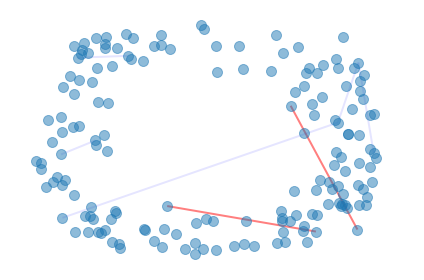

In [448]:
# nodes

fd_loc = nx.spring_layout(nx_hc1,iterations=10)
# fd_loc = forceatlas2.forceatlas2_networkx_layout(nx_hc1, pos=None, iterations=2000)

nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=100,alpha=0.5,)
# elarge = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.5]
# esmall = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] <= 0.7]

epos = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.9]
eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]
# edges
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=2,  alpha=0.5, edge_color="r", 
                       #style="dashed"
                      )
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=2,  alpha=0.1, edge_color="b", 
                       #style="dashed"
                      )
# nx.draw_networkx_edges(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), edgelist=esmall, width=6, alpha=0.5, edge_color="b", style="dashed")

# node labels
# nx.draw_networkx_labels(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), font_size=20, font_family="sans-serif")
# edge weight labels
# edge_labels = nx.get_edge_attributes(G, "weight")
# nx.draw_networkx_edge_labels(G, pos, edge_labels)

ax = plt.gca()
ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()

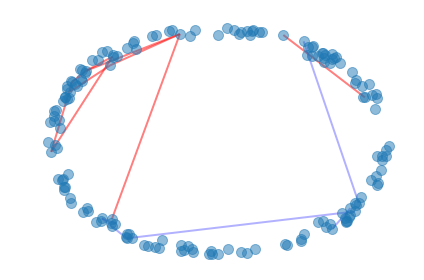

In [449]:
# nodes

fd_loc = nx.spring_layout(nx_hc1,iterations=100)
# fd_loc = forceatlas2.forceatlas2_networkx_layout(nx_hc1, pos=None, iterations=2000)

nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=100,alpha=0.5,)
# elarge = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.5]
# esmall = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] <= 0.7]

epos = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.8]
eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]
# edges
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=2,  alpha=0.5, edge_color="r", 
                       #style="dashed"
                      )
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=2,  alpha=0.3, edge_color="b", 
                       #style="dashed"
                      )
# nx.draw_networkx_edges(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), edgelist=esmall, width=6, alpha=0.5, edge_color="b", style="dashed")

# node labels
# nx.draw_networkx_labels(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), font_size=20, font_family="sans-serif")
# edge weight labels
# edge_labels = nx.get_edge_attributes(G, "weight")
# nx.draw_networkx_edge_labels(G, pos, edge_labels)

ax = plt.gca()
ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()

In [450]:
# # nodes
# nx.draw_networkx_nodes(nx_hc1,pos=nx.spectral_layout(nx_hc1), node_size=50)
# elarge = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] > 0.9]
# esmall = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] <= 0.9]
# # edges
# nx.draw_networkx_edges(nx_hc1,pos=nx.spectral_layout(nx_hc1), edgelist=elarge, width=1)
# # nx.draw_networkx_edges(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), edgelist=esmall, width=6, alpha=0.5, edge_color="b", style="dashed")

# # node labels
# # nx.draw_networkx_labels(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), font_size=20, font_family="sans-serif")
# # edge weight labels
# # edge_labels = nx.get_edge_attributes(G, "weight")
# # nx.draw_networkx_edge_labels(G, pos, edge_labels)

# ax = plt.gca()
# ax.margins(0.08)
# plt.axis("off")
# plt.tight_layout()
# plt.show()

# # # nodes
# # nx.draw_networkx_nodes(absnx_hc1,pos=nx.spectral_layout(absnx_hc1), node_size=50)
# # elarge = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] > 0.9]
# # esmall = [(u, v) for (u, v, d) in G.edges(data=True) if d["weight"] <= 0.9]
# # # edges
# # nx.draw_networkx_edges(absnx_hc1,pos=nx.spectral_layout(absnx_hc1), edgelist=elarge, width=1)
# # # nx.draw_networkx_edges(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), edgelist=esmall, width=6, alpha=0.5, edge_color="b", style="dashed")

# # # node labels
# # # nx.draw_networkx_labels(absnx_hc1,pos=nx.kamada_kawai_layout(absnx_hc1), font_size=20, font_family="sans-serif")
# # # edge weight labels
# # # edge_labels = nx.get_edge_attributes(G, "weight")
# # # nx.draw_networkx_edge_labels(G, pos, edge_labels)

# # ax = plt.gca()
# # ax.margins(0.08)
# # plt.axis("off")
# # plt.tight_layout()
# # plt.show()

In [451]:
##### the clever idea  - use AAL3
##### load AAL3 x,y,z coordinates and replace them in the pos variable 
##### the only issue is that we can do two directions at a time. for 3D we need 3D library - TODO

In [452]:
aal3 = pd.read_csv('aal3_3D_coordinates_names.csv')

In [453]:
aal3

,x,y,z,label,region_id,name
0,-38.930200,-6.96143,49.6404,1,Region1,Precentral_L
1,41.100900,-9.54984,50.8098,2,Region2,Precentral_R
2,-20.168000,35.95520,35.2374,3,Region3,Frontal_Sup_2_L
3,22.551300,33.19270,37.3437,4,Region4,Frontal_Sup_2_R
4,-35.527000,32.87290,29.9379,5,Region5,Frontal_Mid_2_L
...,...,...,...,...,...,...
161,5.931030,-19.48280,-10.6552,166,Region166,Red_N_R
162,-4.000000,-34.80000,-26.0000,167,Region167,LC_L
163,6.000000,-35.20000,-28.0000,168,Region168,LC_R
164,0.777778,-27.00000,-10.4444,169,Region169,Raphe_D


In [454]:
# fd_loc

In [455]:
#####
coord_x = aal3['x'].values
coord_y = aal3['y'].values
coord_z = aal3['z'].values

reg_names = aal3['name'].values

In [456]:
# reg_names

In [457]:
reg_dir = [item[-1] for item in reg_names]

In [458]:
# reg_dir

In [459]:
dict_xy = {}
dict_yx = {}
dict_yz = {}
dict_zy = {}
dict_xz = {}
dict_zx = {}
dict_names = {}
dict_dir = {}

In [460]:
for i in range(166):
    dict_xy[i] = np.array((coord_x[i],coord_y[i]))
    dict_yx[i] = np.array((coord_y[i],coord_x[i]))
    dict_yz[i] = np.array((coord_y[i],coord_z[i]))
    dict_zy[i] = np.array((coord_z[i],coord_y[i]))
    dict_xz[i] = np.array((coord_x[i],coord_z[i]))
    dict_zx[i] = np.array((coord_z[i],coord_x[i]))
    
    dict_names[i] = reg_names[i]
    dict_dir[i]   = reg_dir[i]

In [461]:
# dict_xy

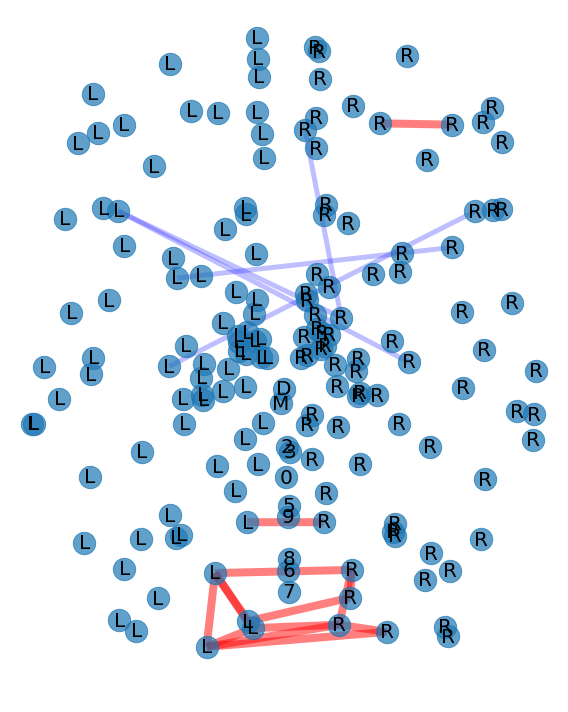

In [462]:
# nodes

# fig, axs = plt.subplots(2, 2, figsize=(20, 15))
plt.figure(figsize=(8,10))
fd_loc = dict_xy
nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=500,alpha=0.7,)
epos = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.7]
eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]
# edges
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=8,  alpha=0.5, edge_color="r")
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=5,  alpha=0.25, edge_color="b")
# node labels
# nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_names, font_size=6, font_family="sans-serif")

nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_dir, font_size=20, font_family="sans-serif")
ax = plt.gca()
# ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()

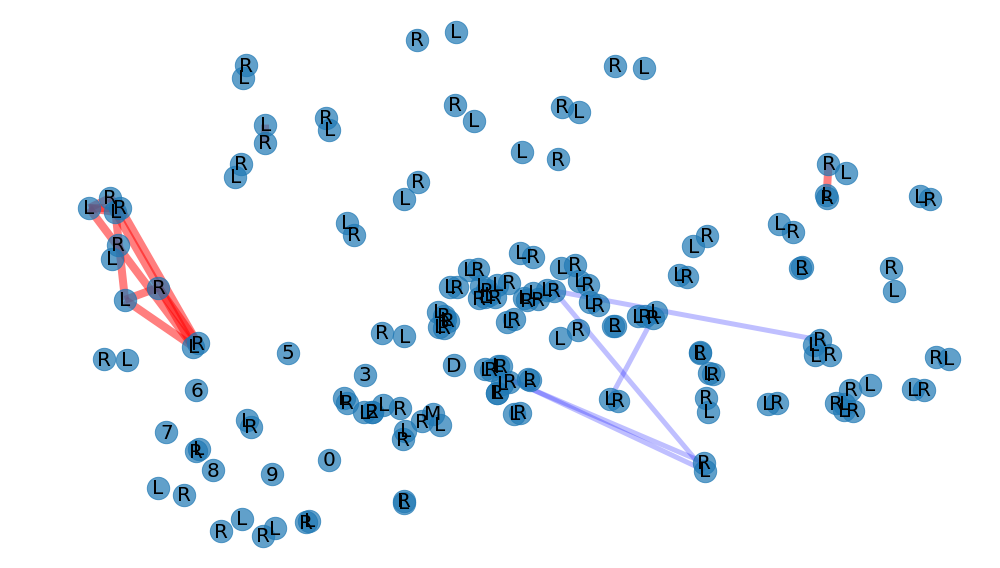

In [463]:
# nodes

# fig, axs = plt.subplots(2, 2, figsize=(20, 15))
plt.figure(figsize=(14,8))
fd_loc = dict_yz
nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=500,alpha=0.7,)
epos = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.7]
eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]
# edges
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=8,  alpha=0.5, edge_color="r")
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=5,  alpha=0.25, edge_color="b")
# node labels
# nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_names, font_size=6, font_family="sans-serif")

nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_dir, font_size=20, font_family="sans-serif")
ax = plt.gca()
# ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()

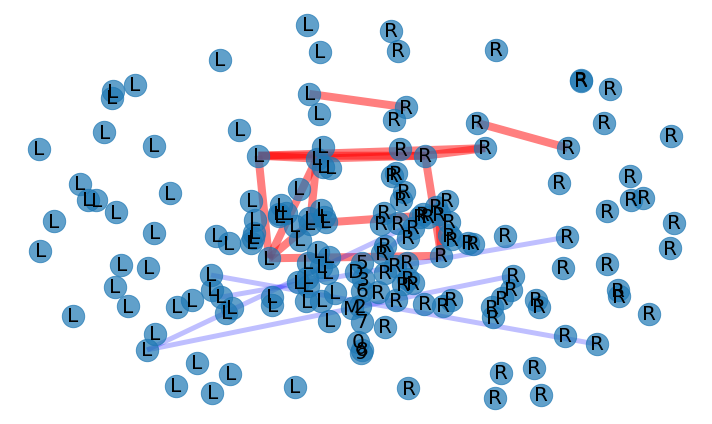

In [464]:
# nodes

# fig, axs = plt.subplots(2, 2, figsize=(20, 15))
plt.figure(figsize=(10,6))
fd_loc = dict_xz
nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=500,alpha=0.7,)
epos = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.7]
eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]
# edges
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=8,  alpha=0.5, edge_color="r")
nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=5,  alpha=0.25, edge_color="b")
# node labels
# nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_names, font_size=6, font_family="sans-serif")

nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_dir, font_size=20, font_family="sans-serif")
ax = plt.gca()
# ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()

In [465]:
######### now 3D plots; we need 3D coords

dict_xyz = {}

for i in range(166):
    dict_xyz[i] = np.array((coord_x[i],coord_y[i],coord_z[i]))
    
fd_loc = dict_xyz

In [466]:
# dict_xyz
# from mpl_toolkits.mplot3d import Axes3D

In [467]:
## this is uselss code: going to plotly

# # Get node positions

# #### define graph

# G = nx_hc1

# pos = dict_xyz

# # Get number of nodes
# n = G.number_of_nodes()

# # Get the maximum number of edges adjacent to a single node
# edge_max = max([G.degree(i) for i in range(n)])

# # Define color range proportional to number of edges adjacent to a single node
# colors = [plt.cm.plasma(G.degree(i)/edge_max) for i in range(n)] 

# # 3D network plot
# # with plt.style.context(('ggplot')):

# fig = plt.figure(figsize=(10,7))
# ax = Axes3D(fig)

# # Loop on the pos dictionary to extract the x,y,z coordinates of each node
# for key, value in pos.items():
#     xi = value[0]
#     yi = value[1]
#     zi = value[2]

#     # Scatter plot
#     ax.scatter(xi, yi, zi, color=colors[key], s=2+2*G.degree(key), edgecolors='k', alpha=0.7)

# # Loop on the list of edges to get the x,y,z, coordinates of the connected nodes
# # Those two points are the extrema of the line to be plotted
# for i,j in enumerate(G.edges()):

#     x = np.array((pos[j[0]][0], pos[j[1]][0]))
#     y = np.array((pos[j[0]][1], pos[j[1]][1]))
#     z = np.array((pos[j[0]][2], pos[j[1]][2]))

# # Plot the connecting lines
#     ax.plot(x, y, z, c='black', alpha=0.5)

# # Set the initial view
# # ax.view_init(30, angle)

# # Hide the axes
# ax.set_axis_off()

# #  if save is not False:
# #      plt.savefig("C:\scratch\\data\"+str(angle).zfill(3)+".png")
# #      plt.close('all')
# #  else:
# #       plt.show()
# plt.show()

In [468]:
############# trying plotly with igraph

In [469]:
# import igraph as ig

In [470]:
# h = ig.Graph.from_networkx(nx_hc1)

In [471]:
# A = nx_hc1.get_edgelist()
# G = networkx.DiGraph(A)

In [472]:
# # Plot the same network with NetworkX and igraph
# fig, (ax0, ax1) = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# # NetworkX draw
# ax0.set_title("Plot with NetworkX draw")
# nx.draw_spring(h, node_size=50, ax=ax0)

# # igraph draw
# ax1.set_title("Plot with igraph plot")
# # layout = h.layout_kamada_kawai()
# ig.plot(h, layout=layout, target=ax1)
# plt.axis("off")
# plt.show()

In [473]:
# nx_hc1.nodes

In [474]:
# g = ig.Graph.Weighted_Adjacency(std_hc1)

In [475]:
# g

In [476]:

# # Plot the same network with NetworkX and igraph
# fig, (ax0, ax1) = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# # igraph draw
# ax1.set_title("Plot with igraph plot")
# layout = g.layout_kamada_kawai()
# ig.plot(g, target=ax1)
# plt.axis("off")
# plt.show()

In [477]:
# dict_xyz
# sorted(nx_hc1)

In [478]:
# [dict_xyz[v] for v in sorted(nx_hc1)]

In [479]:
# # nodes

# # fig, axs = plt.subplots(2, 2, figsize=(20, 15))
# # plt.figure()
# # Create the 3D figure
# fig = plt.figure(figsize=(18,10))
# ax = fig.add_subplot(111, projection="3d")
# fd_loc = dict_xyz
# # nx.draw_networkx_nodes(nx_hc1,pos=fd_loc, node_size=500,alpha=0.7,)

# node_xyz = np.array([fd_loc[v] for v in sorted(nx_hc1)])
# # Plot the nodes - alpha is scaled by "depth" automatically
# ax.scatter(*node_xyz.T, s=100, ec="w")

# epos = [(fd_loc[u], fd_loc[v]) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.95]
# eneg = [(fd_loc[u], fd_loc[v]) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]

# # Plot the edges
# for edgeitem in epos:
#     ax.plot(edgeitem[0],edgeitem[1], color="tab:red")
#     break
# # edges
# # nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=epos, width=8,  alpha=0.5, edge_color="r")
# # nx.draw_networkx_edges(nx_hc1,pos=fd_loc, edgelist=eneg, width=5,  alpha=0.25, edge_color="b")
# # # node labels
# # # nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_names, font_size=6, font_family="sans-serif")

# # # nx.draw_networkx_labels(nx_hc1,pos=fd_loc, labels = dict_dir, font_size=20, font_family="sans-serif")
# # ax = plt.gca()


# # # ax.margins(0.08)
# # plt.axis("off")
# # plt.tight_layout()
# # plt.show()
# def _format_axes(ax):
#     """Visualization options for the 3D axes."""
#     # Turn gridlines off
#     ax.grid(False)
#     # Suppress tick labels
#     # for dim in (ax.xaxis, ax.yaxis, ax.zaxis):
#     #     dim.set_ticks([])
#     # Set axes labels
#     ax.set_xlabel("x")
#     ax.set_ylabel("y")
#     ax.set_zlabel("z")


# _format_axes(ax)
# fig.tight_layout()
# plt.show()


#### good but not the best - this code is incomplete - it would require some debugging

In [480]:
########## plotly 3D plots
from  plotly.offline import plot
import chart_studio.plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

In [481]:
# epos = [(d["weight"])*2 for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.7]
# eneg = [(u, v) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.9]

In [482]:
# epos

In [483]:
### set data for plotly graph

### define the set of pos and neg edges

epos = [(fd_loc[u], fd_loc[v]) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] > 0.5]
eneg = [(fd_loc[u], fd_loc[v]) for (u, v, d) in nx_hc1.edges(data=True) if d["weight"] < -0.5]

In [484]:
# epos

In [485]:
Xn=[dict_xyz[k][0] for k in range(166)]# x-coordinates of nodes
Yn=[dict_xyz[k][1] for k in range(166)]# y-coordinates
Zn=[dict_xyz[k][2] for k in range(166)]# z-coordinates
Xe_pos=[]
Ye_pos=[]
Ze_pos=[]
for e in epos:
    Xe_pos+=[e[0][0],e[1][0], None]# x-coordinates of edge ends pos
    Ye_pos+=[e[0][1],e[1][1], None]# y-coordinates of edge ends pos
    Ze_pos+=[e[0][2],e[1][2], None]# z-coordinates of edge ends pos
    
Xe_neg=[]
Ye_neg=[]
Ze_neg=[]
for e in eneg:
    Xe_neg+=[e[0][0],e[1][0], None]# x-coordinates of edge ends neg
    Ye_neg+=[e[0][1],e[1][1], None]# y-coordinates of edge ends neg
    Ze_neg+=[e[0][2],e[1][2], None]# z-coordinates of edge ends neg

In [486]:
# epos

In [487]:
labels = reg_names

In [488]:
# temp_size = [10]*84 + [5]*84


In [489]:
# temp_size

In [490]:
trace1=go.Scatter3d(x=Xe_pos, y=Ye_pos, z=Ze_pos, mode='lines', line=dict(color='rgb(128,0,0)', width=10),hoverinfo='none', name='Positive Correlation')
trace2=go.Scatter3d(x=Xe_neg, y=Ye_neg, z=Ze_neg, mode='lines', line=dict(color='rgb(0,0,128)', width=0.5),hoverinfo='none',name='Negative Correlation')
trace3=go.Scatter3d(x=Xn, y=Yn, z=Zn, mode='markers', marker=dict(symbol='circle', size=10, color='grey', colorscale='Viridis',                              
                    line=dict(color='rgb(0,0,0)', width=0.5)), text=labels, hoverinfo='text', name='AAL3 Nodes')
axis=dict(showbackground=False,showline=False,zeroline=False,showgrid=False, showticklabels=False, title='')
layout = go.Layout(title="Brain Visualization", width=1300, height=1000, showlegend=True,  
            scene=dict(xaxis=dict(axis), yaxis=dict(axis), zaxis=dict(axis), ), margin=dict(t=100
    ),hovermode='closest', annotations=[dict(showarrow=False, text="",xref='paper', yref='paper',
            x=0, y=0.1,  xanchor='left', yanchor='bottom',font=dict(size=14))],   )
data=[trace1, trace2, trace3]
fig=go.Figure(data=data, layout=layout)
from IPython.display import HTML
fig.update_layout(hoverlabel=dict(bgcolor="white",font_size=28,font_family="Courier"),
    legend=dict(x=0,y=1,title_font_family="Times New Roman",
        font=dict(family="Courier",size=20,color="black"),
        bgcolor="white",bordercolor="Black",borderwidth=0.5
    ),title=dict(text="Brain Connectome Visualization in 3D", font=dict(size=50))
)
HTML(fig.to_html())

In [316]:
############### now 2D plots of plotly

In [442]:
trace1=go.Scatter(x=Xe_pos, y=Ye_pos, mode='lines', line=dict(color='rgb(128,0,0)', width=10),hoverinfo='none', name='Positive Correlation')
trace2=go.Scatter(x=Xe_neg, y=Ye_neg, mode='lines', line=dict(color='rgb(0,0,128)', width=0.5),hoverinfo='none',name='Negative Correlation')
trace3=go.Scatter(x=Xn, y=Yn, mode='markers', marker=dict(symbol='circle', size=10, color='grey', colorscale='Viridis',                              
                    line=dict(color='rgb(0,0,0)', width=0.5)), text=labels, hoverinfo='text', name='AAL3 Nodes')
axis=dict(showbackground=False,showline=False,zeroline=False,showgrid=False, showticklabels=False, title='')
layout = go.Layout(title="Brain Visualization ", width=1000, height=1000, showlegend=True,  
            scene=dict(xaxis=dict(axis), yaxis=dict(axis), zaxis=dict(axis), ), margin=dict(t=100),hovermode='closest',
    annotations=[dict(showarrow=False,text="",xref='paper',yref='paper',x=0,y=0.1,xanchor='left',yanchor='bottom',font=dict(size=14))],)
data=[trace1, trace2, trace3]
fig=go.Figure(data=data, layout=layout)
from IPython.display import HTML
fig.update_layout(hoverlabel=dict(bgcolor="white",font_size=20,font_family="Courier"),
    legend=dict(x=0,y=1,title_font_family="Times New Roman",
        font=dict(family="Courier",size=20,color="black"),
        bgcolor="white",bordercolor="Black",borderwidth=0.5
    ),title=dict(text="Brain Connectome Visualization in 2D | X-Y Plane", font=dict(size=40))
)
HTML(fig.to_html())

In [322]:
trace1=go.Scatter(x=Xe_pos, y=Ze_pos, mode='lines', line=dict(color='rgb(128,0,0)', width=10),hoverinfo='none', name='Positive Correlation')
trace2=go.Scatter(x=Xe_neg, y=Ze_neg, mode='lines', line=dict(color='rgb(0,0,128)', width=0.5),hoverinfo='none',name='Negative Correlation')
trace3=go.Scatter(x=Xn, y=Zn, mode='markers', marker=dict(symbol='circle', size=10, color='grey', colorscale='Viridis',                              
                    line=dict(color='rgb(0,0,0)', width=0.5)), text=labels, hoverinfo='text', name='AAL3 Nodes')
axis=dict(showbackground=False,showline=False,zeroline=False,showgrid=False, showticklabels=False, title='')
layout = go.Layout(title="Brain Visualization ", width=1000, height=1000, showlegend=True,  
            scene=dict(xaxis=dict(axis), yaxis=dict(axis), zaxis=dict(axis), ), margin=dict(t=100),hovermode='closest',
    annotations=[dict(showarrow=False,text="",xref='paper',yref='paper',x=0,y=0.1,xanchor='left',yanchor='bottom',font=dict(size=14))],)
data=[trace1, trace2, trace3]
fig=go.Figure(data=data, layout=layout)
from IPython.display import HTML
fig.update_layout(hoverlabel=dict(bgcolor="white",font_size=20,font_family="Courier"),
    legend=dict(x=0,y=1,title_font_family="Times New Roman",
        font=dict(family="Courier",size=20,color="black"),
        bgcolor="white",bordercolor="Black",borderwidth=0.5
    ),title=dict(text="Brain Connectome Visualization in 2D | X-Z Plane", font=dict(size=40))
)
HTML(fig.to_html())

In [323]:
trace1=go.Scatter(x=Ye_pos, y=Ze_pos, mode='lines', line=dict(color='rgb(128,0,0)', width=10),hoverinfo='none', name='Positive Correlation')
trace2=go.Scatter(x=Ye_neg, y=Ze_neg, mode='lines', line=dict(color='rgb(0,0,128)', width=0.5),hoverinfo='none',name='Negative Correlation')
trace3=go.Scatter(x=Yn, y=Zn, mode='markers', marker=dict(symbol='circle', size=10, color='grey', colorscale='Viridis',                              
                    line=dict(color='rgb(0,0,0)', width=0.5)), text=labels, hoverinfo='text', name='AAL3 Nodes')
axis=dict(showbackground=False,showline=False,zeroline=False,showgrid=False, showticklabels=False, title='')
layout = go.Layout(title="Brain Visualization ", width=1000, height=1000, showlegend=True,  
            scene=dict(xaxis=dict(axis), yaxis=dict(axis), zaxis=dict(axis), ), margin=dict(t=100),hovermode='closest',
    annotations=[dict(showarrow=False,text="",xref='paper',yref='paper',x=0,y=0.1,xanchor='left',yanchor='bottom',font=dict(size=14))],)
data=[trace1, trace2, trace3]
fig=go.Figure(data=data, layout=layout)
from IPython.display import HTML
fig.update_layout(hoverlabel=dict(bgcolor="white",font_size=20,font_family="Courier"),
    legend=dict(x=0,y=1,title_font_family="Times New Roman",
        font=dict(family="Courier",size=20,color="black"),
        bgcolor="white",bordercolor="Black",borderwidth=0.5
    ),title=dict(text="Brain Connectome Visualization in 2D | Y-Z Plane", font=dict(size=40))
)
HTML(fig.to_html())